#  Exploratory Data Analysis  <a id='data_preparation'></a>

In [1]:
#LIBRARIES
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
rcParams['figure.figsize'] = 20, 10
from warnings import filterwarnings
filterwarnings('ignore')
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import GaussianNB

In [2]:
data = pd.read_csv("C:/Users/Rachel Kuek/OneDrive/Desktop/EE0005/archive/cardio_train.csv",sep=";")

In [57]:
data.head()

,id,age,gender,gender_label,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,50.0,Male,Male,168,62.0,110,80,1,1,0,0,1,0
1,1,55.0,Female,Female,156,85.0,140,90,3,1,0,0,1,1
2,2,52.0,Female,Female,165,64.0,130,70,3,1,0,0,0,1
3,3,48.0,Male,Male,169,82.0,150,100,1,1,0,0,1,1
4,4,48.0,Female,Female,156,56.0,100,60,1,1,0,0,0,0


## Data Dimensions <a id='Data_Shape'></a>

In [4]:
data.shape

(70000, 13)

In [5]:
print(f'There are {data.shape[0]} data points and {data.shape[1]} features in the dataset')

There are 70000 data points and 13 features in the dataset


##  Data Types <a id='Data_Types'></a>

In [6]:
data.dtypes

id               int64
age              int64
gender           int64
height           int64
weight         float64
ap_hi            int64
ap_lo            int64
cholesterol      int64
gluc             int64
smoke            int64
alco             int64
active           int64
cardio           int64
dtype: object

## Data Information

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           70000 non-null  int64  
 1   age          70000 non-null  int64  
 2   gender       70000 non-null  int64  
 3   height       70000 non-null  int64  
 4   weight       70000 non-null  float64
 5   ap_hi        70000 non-null  int64  
 6   ap_lo        70000 non-null  int64  
 7   cholesterol  70000 non-null  int64  
 8   gluc         70000 non-null  int64  
 9   smoke        70000 non-null  int64  
 10  alco         70000 non-null  int64  
 11  active       70000 non-null  int64  
 12  cardio       70000 non-null  int64  
dtypes: float64(1), int64(12)
memory usage: 6.9 MB


In [8]:
data.describe()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,49972.419900,19468.865814,1.349571,164.359229,74.205690,128.817286,96.630414,1.366871,1.226457,0.088129,0.053771,0.803729,0.499700
std,28851.302323,2467.251667,0.476838,8.210126,14.395757,154.011419,188.472530,0.680250,0.572270,0.283484,0.225568,0.397179,0.500003
min,0.000000,10798.000000,1.000000,55.000000,10.000000,-150.000000,-70.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,25006.750000,17664.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
50%,50001.500000,19703.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,74889.250000,21327.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.000000,0.000000,1.000000,1.000000
max,99999.000000,23713.000000,2.000000,250.000000,200.000000,16020.000000,11000.000000,3.000000,3.000000,1.000000,1.000000,1.000000,1.000000


In [9]:
data['age']=(data['age']/365.242199).round() #Convert age (days) to years


In [10]:
data['age'].head() #Double check

0    50.0
1    55.0
2    52.0
3    48.0
4    48.0
Name: age, dtype: float64

## Gender of Patients 

In [11]:
data['gender'].value_counts()

1    45530
2    24470
Name: gender, dtype: int64

# Feature Engineering
#### What does the number 1 or 2 represents, male or female?
#### We can determine the gender by comparing the ap_hi (Systolic Blood Pressure), ap_low (Diastolic Blood Pressure) and the mean height. Generally males have higher values in every aspects.

In [12]:
# Calculate the average ap_lo, ap_hi, and height for gender 1
aplo_1l = data.loc[data['gender'] == 1, 'ap_lo'] # Diastolic Blood Pressure
aplo_1h = data.loc[data['gender'] == 1, 'ap_hi'] # Systolic Blood Pressure
height_1 = data.loc[data['gender'] == 1, 'height'] / 100 # Height in m

average_aplo_1l = round(aplo_1l.mean(), 2)
average_aplo_1h = round(aplo_1h.mean(), 2)
average_height_1 = round(height_1.mean(), 2)

print("The average ap_lo for gender 1 is:", average_aplo_1l)
print("The average ap_hi for gender 1 is:", average_aplo_1h)
print("The average height for gender 1 is:", average_height_1)

# Calculate the average ap_lo, ap_hi, and height for gender 2
aplo_2l = data.loc[data['gender'] == 2, 'ap_lo'] # Diastolic Blood Pressure
aplo_2h = data.loc[data['gender'] == 2, 'ap_hi'] # Systolic Blood Pressure
height_2 = data.loc[data['gender'] == 2, 'height'] / 100 # Height in m

average_aplo_2l = round(aplo_2l.mean(), 2)
average_aplo_2h = round(aplo_2h.mean(), 2)
average_height_2 = round(height_2.mean(), 2)

print("\nThe average ap_lo for gender 2 is:", average_aplo_2l)
print("The average ap_hi for gender 2 is:", average_aplo_2h)
print("The average height for gender 2 is:", average_height_2)

# cardiodata.insert(2, "female", (cardiodata['gender'] == 1).astype(int))
# cardiodata.insert(3, "male", (cardiodata['gender'] == 2).astype(int))

data.insert(3, "gender_label", data["gender"].replace({1: "Female", 2: "Male"}))
data.head()

The average ap_lo for gender 1 is: 94.52
The average ap_hi for gender 1 is: 128.14
The average height for gender 1 is: 1.61

The average ap_lo for gender 2 is: 100.55
The average ap_hi for gender 2 is: 130.08
The average height for gender 2 is: 1.7


,id,age,gender,gender_label,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,50.0,2,Male,168,62.0,110,80,1,1,0,0,1,0
1,1,55.0,1,Female,156,85.0,140,90,3,1,0,0,1,1
2,2,52.0,1,Female,165,64.0,130,70,3,1,0,0,0,1
3,3,48.0,2,Male,169,82.0,150,100,1,1,0,0,1,1
4,4,48.0,1,Female,156,56.0,100,60,1,1,0,0,0,0


### From this, we can conclude that gender 1 is Female and gender 2 is Male.

In [56]:
##Replace gender to Male and Female respectively according to the dataset
data['gender'] = data['gender'].replace({1: 'Female', 2: 'Male'})
data.head()

,id,age,gender,gender_label,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,50.0,Male,Male,168,62.0,110,80,1,1,0,0,1,0
1,1,55.0,Female,Female,156,85.0,140,90,3,1,0,0,1,1
2,2,52.0,Female,Female,165,64.0,130,70,3,1,0,0,0,1
3,3,48.0,Male,Male,169,82.0,150,100,1,1,0,0,1,1
4,4,48.0,Female,Female,156,56.0,100,60,1,1,0,0,0,0


In [15]:
#Separate gender into 2 different dataframes
male_df = data[data['gender'] == 'Male']
female_df = data[data['gender'] == 'Female']

In [16]:
# View the first 5 rows of the male data
male_df.head()

,id,age,gender,gender_label,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,50.0,Male,Male,168,62.0,110,80,1,1,0,0,1,0
3,3,48.0,Male,Male,169,82.0,150,100,1,1,0,0,1,1
7,12,62.0,Male,Male,178,95.0,130,90,3,3,0,0,1,1
11,16,52.0,Male,Male,173,60.0,120,80,1,1,0,0,1,0
12,18,40.0,Male,Male,165,60.0,120,80,1,1,0,0,0,0


In [17]:
# View the first 5 rows of the female data
female_df.head()

,id,age,gender,gender_label,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
1,1,55.0,Female,Female,156,85.0,140,90,3,1,0,0,1,1
2,2,52.0,Female,Female,165,64.0,130,70,3,1,0,0,0,1
4,4,48.0,Female,Female,156,56.0,100,60,1,1,0,0,0,0
5,8,60.0,Female,Female,151,67.0,120,80,2,2,0,0,0,0
6,9,61.0,Female,Female,157,93.0,130,80,3,1,0,0,1,0


# Feature Selection
##  Data Visualisation

In [18]:
#Drop "id" columns as it is not necessary for our data analysis
male_df = male_df.drop('id', axis=1)
female_df = female_df.drop('id', axis=1)

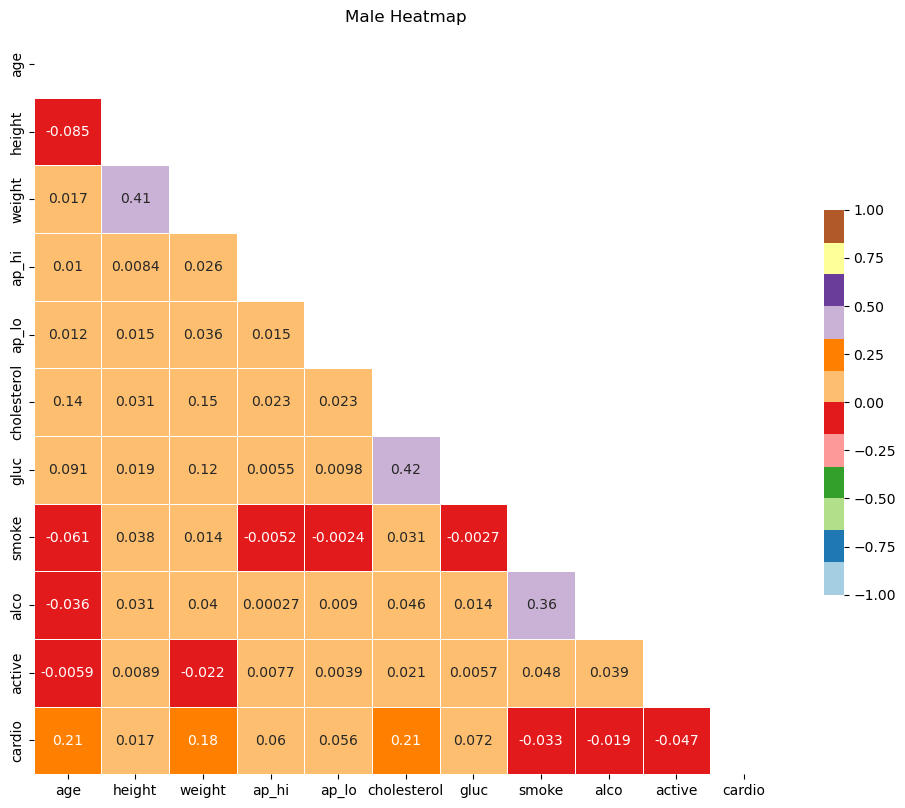

In [19]:
plt.figure(figsize=(12,10))

corr = male_df.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

sns_plot = sns.heatmap(corr, mask=mask, annot=True, cmap='Paired', vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns_plot.set_title("Male Heatmap")
plt.show()

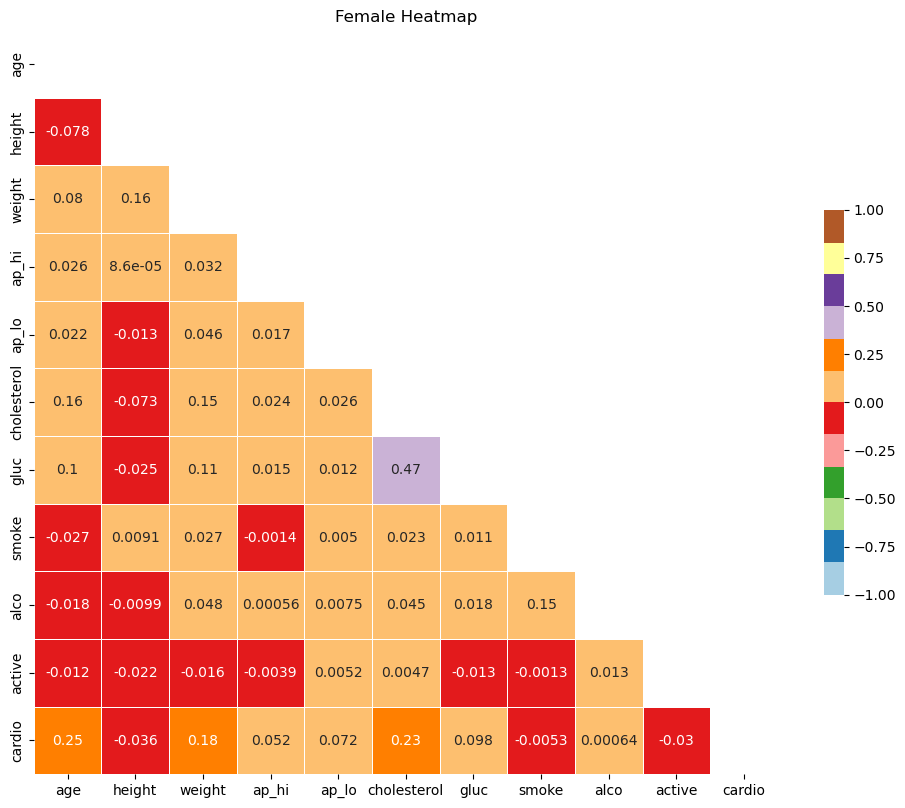

In [20]:
plt.figure(figsize=(12,10))

corr = female_df.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

sns_plot = sns.heatmap(corr, mask=mask, annot=True, cmap='Paired', vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns_plot.set_title("Female Heatmap")
plt.show()

### High correlation between gluc and cholesterol, smoke and gender, medium correlation between cardio disease and age, cardio disease and weight, cardio disease and cholesterol, low correlation between smoke and age, height and cardio.

## Removing outliers

In [21]:
#Let's remove weights and heights, that fall below 2.5% or above 97.5% of a given range.
#Tree standard deviation range to remove any wrong information from the data

data.drop(data[(data['height'] > data['height'].quantile(0.975)) | (data['height'] < data['height'].quantile(0.025))].index,inplace=True)
data.drop(data[(data['weight'] > data['weight'].quantile(0.975)) | (data['weight'] < data['weight'].quantile(0.025))].index,inplace=True)

In [22]:
#In addition, in some cases diastolic pressure is higher than systolic, which is also incorrect. How many records are inaccurate in terms of blood pressure?
print("Diastolic pressure is higher than systolic one in {0} cases".format(data[data['ap_lo']> data['ap_hi']].shape[0]))

Diastolic pressure is higher than systolic one in 1082 cases


In [23]:
#Let's get rid of the outliers, moreover blood pressure could not be negative value!

data.drop(data[(data['ap_hi'] > data['ap_hi'].quantile(0.975)) | (data['ap_hi'] < data['ap_hi'].quantile(0.025))].index,inplace=True)
data.drop(data[(data['ap_lo'] > data['ap_lo'].quantile(0.975)) | (data['ap_lo'] < data['ap_lo'].quantile(0.025))].index,inplace=True)

In [24]:
#Separate gender into 2 different dataframes
male_df = data[data['gender'] == 'Male']
female_df = data[data['gender'] == 'Female']

In [25]:
male_df = male_df.drop('id', axis=1)
female_df = female_df.drop('id', axis=1)

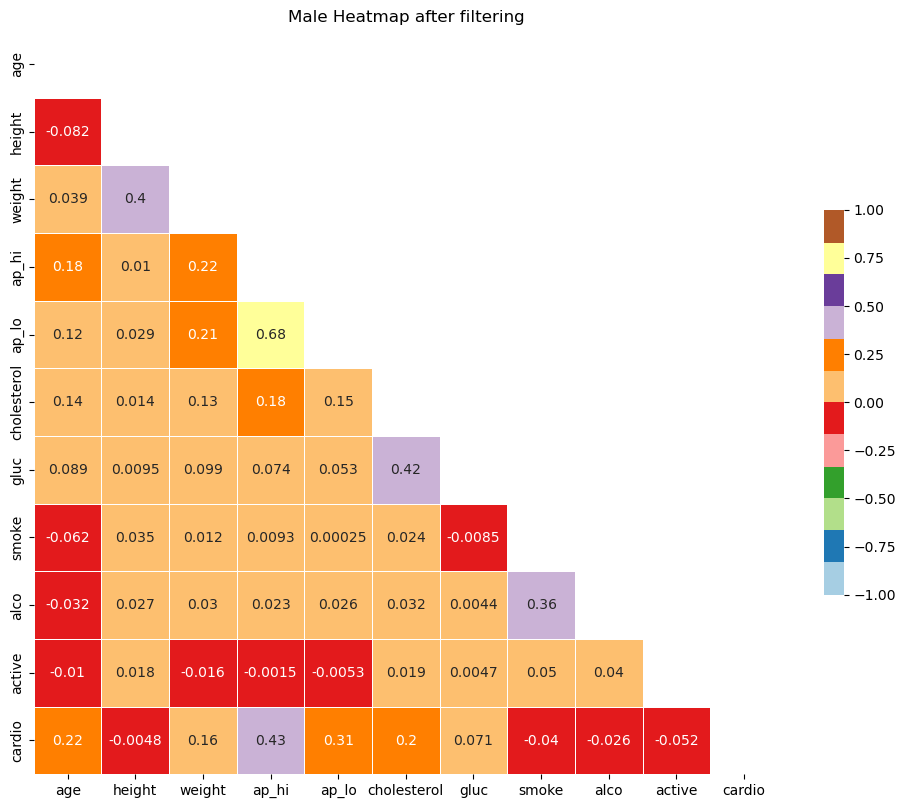

In [26]:
plt.figure(figsize=(12,10))

corr = male_df.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

sns_plot = sns.heatmap(corr, mask=mask, annot=True, cmap='Paired', vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns_plot.set_title("Male Heatmap after filtering")
plt.show()

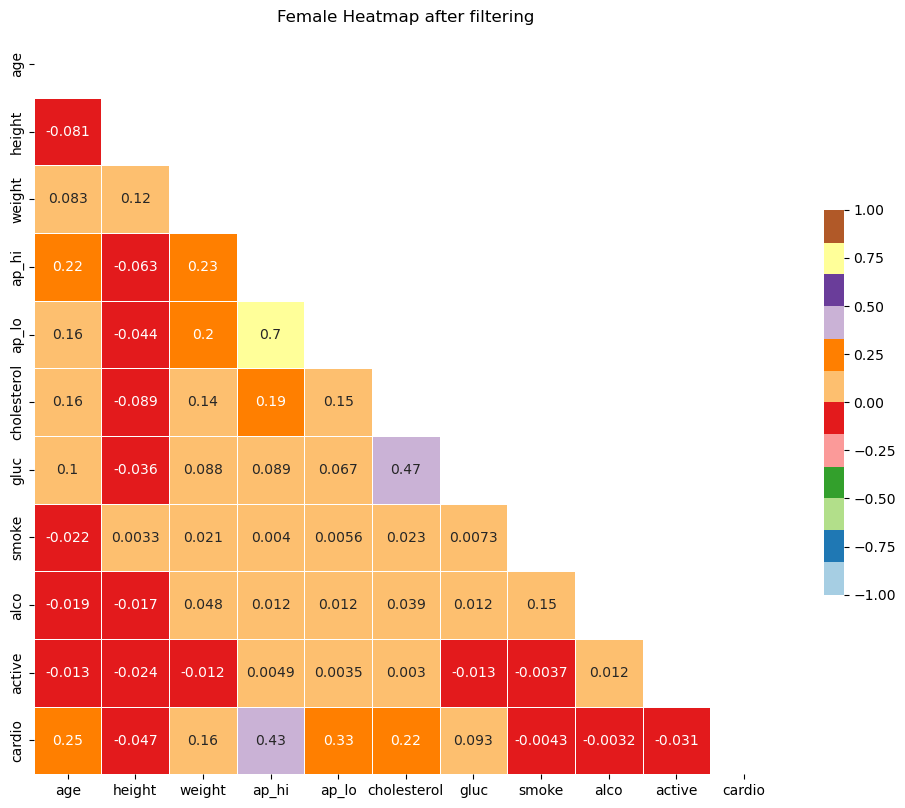

In [27]:
plt.figure(figsize=(12,10))

corr = female_df.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

sns_plot = sns.heatmap(corr, mask=mask, annot=True, cmap='Paired', vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns_plot.set_title("Female Heatmap after filtering")
plt.show()

In [28]:
data2 = pd.read_csv("C:/Users/Rachel Kuek/OneDrive/Desktop/EE0005/archive/cardio_train.csv", sep=";")

In [29]:
diff = data2.shape[0] - data.shape[0]
print("Amount of duplicate and outlier entries:", diff)

Amount of duplicate and outlier entries: 9858


In [30]:
percentage = (diff/data.shape[0]) * 100
print("% of duplicate and outlier entries:", percentage)

% of duplicate and outlier entries: 16.391207475640986


### Data Distribution of Features (Parallel Categorical Diagram) <a id='dist_feature'></a>

In [55]:
import plotly.graph_objects as go
import pandas as pd

# Create dimensions
class_dim = go.parcats.Dimension(
    values=data.gender,
    categoryorder='category ascending', label="Gender"
)

alco_dim = go.parcats.Dimension(values=data.alco, label="Alcohol Consumption")
import plotly.graph_objects as go
import pandas as pd

# Create dimensions
class_dim = go.parcats.Dimension(
    values=data.gender,
    categoryorder='category ascending', label="Gender"
)

alco_dim = go.parcats.Dimension(values=data.alco, label="Alcohol Consumption")

smoke_dim = go.parcats.Dimension(values=data.smoke, label="Smoking")

active_dim = go.parcats.Dimension(values=data.active, label="Fitness Activities")

cardio_dim = go.parcats.Dimension(
    values=data.cardio, label="Cardiovascular Disease", categoryarray=[0, 1],
    ticktext=['No', 'Yes']
)

# Create parcats trace
color = data.cardio;
colorscale = [[0, 'mediumseagreen'], [1, 'lightsteelblue']];

fig = go.Figure(data = [go.Parcats(dimensions=[class_dim, alco_dim, active_dim, smoke_dim, cardio_dim],
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

### Parallel Categorical Diagram (Alcohol)

In [32]:
import plotly.graph_objects as go
import pandas as pd

# Create dimensions
class_dim = go.parcats.Dimension(
    values=data.gender,
    categoryorder='category ascending', label="Gender"
)

alco_dim = go.parcats.Dimension(values=data.alco, label="Alcohol Consumption")

cardio_dim = go.parcats.Dimension(
    values=data.cardio, label="Cardiovascular Disease", categoryarray=[0, 1],
    ticktext=['No', 'Yes']
)

# Create parcats trace
color = data.cardio;
colorscale = [[0, 'mediumseagreen'], [1, 'lightsteelblue']];

fig = go.Figure(data = [go.Parcats(dimensions=[class_dim, alco_dim, cardio_dim],
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

### Parallel Categorical Diagram (Smoking)

In [33]:
import plotly.graph_objects as go
import pandas as pd

# Create dimensions
class_dim = go.parcats.Dimension(
    values=data.gender,
    categoryorder='category ascending', label="Gender"
)

smoke_dim = go.parcats.Dimension(values=data.smoke, label="Smoking")

cardio_dim = go.parcats.Dimension(
    values=data.cardio, label="Cardiovascular Disease", categoryarray=[0, 1],
    ticktext=['No', 'Yes']
)

# Create parcats trace
color = data.cardio;
colorscale = [[0, 'mediumseagreen'], [1, 'lightsteelblue']];

fig = go.Figure(data = [go.Parcats(dimensions=[class_dim, smoke_dim, cardio_dim],
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

### Parallel Categorical Diagram (Fitness Activities)

In [34]:
import plotly.graph_objects as go
import pandas as pd

# Create dimensions
class_dim = go.parcats.Dimension(
    values=data.gender,
    categoryorder='category ascending', label="Gender"
)

active_dim = go.parcats.Dimension(values=data.active, label="Fitness Activities")

cardio_dim = go.parcats.Dimension(
    values=data.cardio, label="Cardiovascular Disease", categoryarray=[0, 1],
    ticktext=['No', 'Yes']
)

# Create parcats trace
color = data.cardio;
colorscale = [[0, 'mediumseagreen'], [1, 'lightsteelblue']];

fig = go.Figure(data = [go.Parcats(dimensions=[class_dim, active_dim, cardio_dim],
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

### Distribution Plot for Male

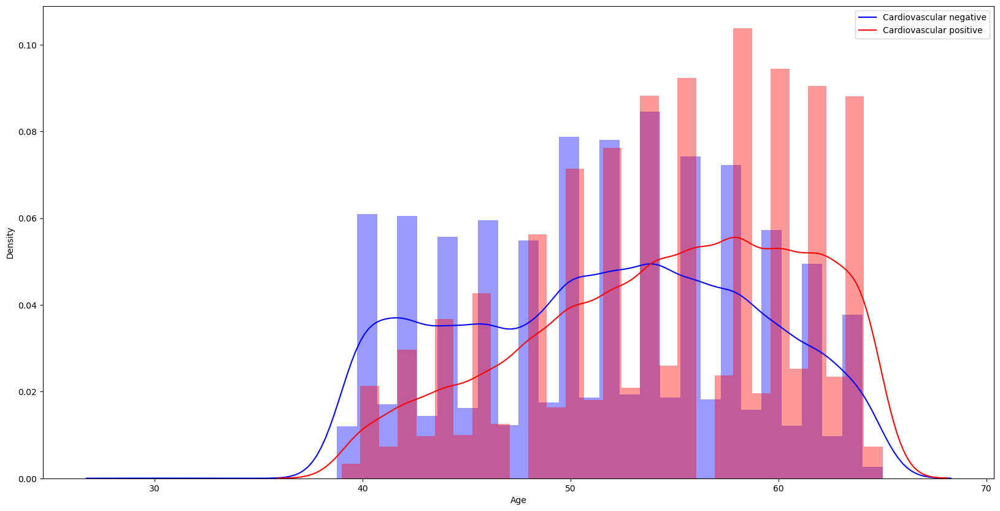

In [35]:
sns.distplot(male_df['age'][male_df['cardio']==0],color='blue')
sns.distplot(male_df['age'][male_df['cardio']==1],color='red')

# add legend and labels
plt.legend(labels=['Cardiovascular negative', 'Cardiovascular positive'])
plt.xlabel('Age')
plt.ylabel('Density')

plt.show()

### Distribution Plot for Female

<AxesSubplot:xlabel='age', ylabel='Density'>

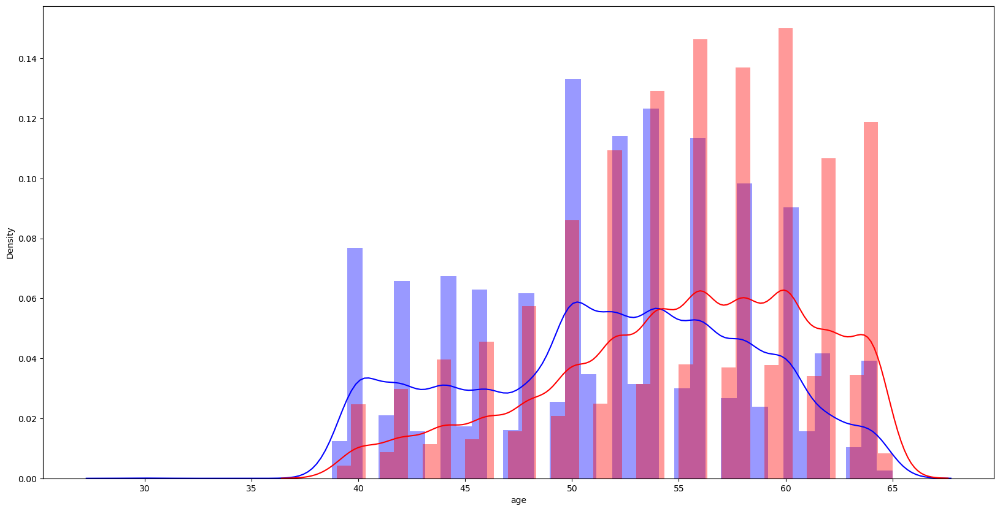

In [36]:
# plot histograms with overlaid kernel density estimates
sns.distplot(female_df['age'][female_df['cardio']==0], color='blue')
sns.distplot(female_df['age'][female_df['cardio']==1], color='red')

### In higher ages there is increase in presence of cardiovascular disease

### Countplot for Male

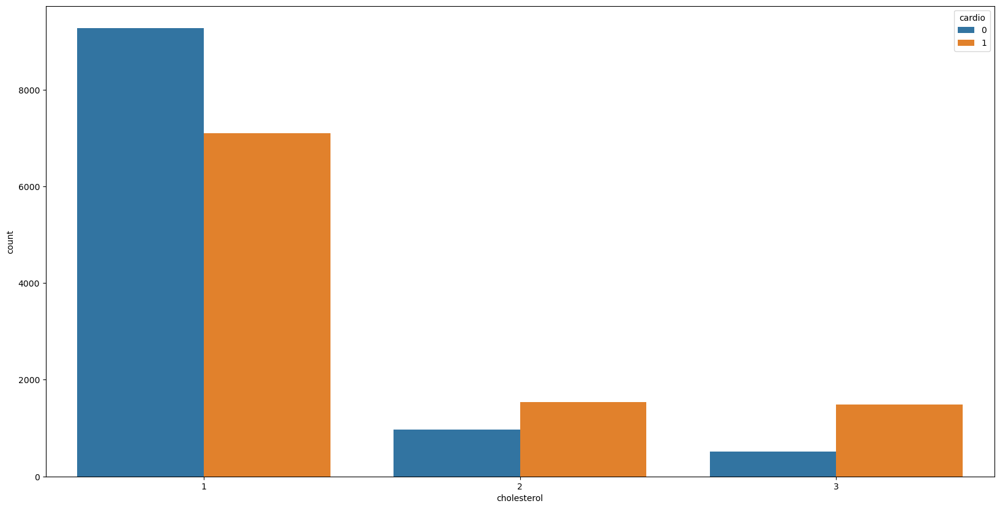

In [37]:
#1 is normal, 2 above normal, 3 is way above normal
sns.countplot(x='cholesterol', hue='cardio', data = male_df);

### Countplot for Female

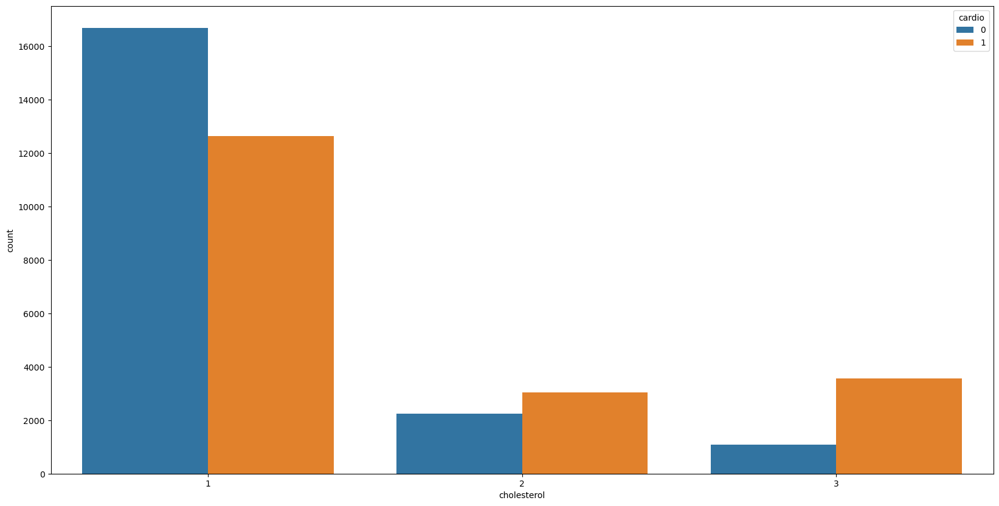

In [38]:
#1 is normal, 2 above normal, 3 is way above normal
sns.countplot(x='cholesterol', hue='cardio', data = female_df);

###  In medical studies there is relationships between cholesterol and cardiovascular disease. Bad cholesterol is called low-density lipoprotein (LDL). This is the culprit that makes plaque form in your arteries. Having too many LDLs can lead to heart disease over time but in the diagram above there is increased in cardiovascular disease patients for normal  cholesterol range

https://www.cdc.gov/cholesterol/ldl_hdl.htm#:~:text=LDL%20(low%2Ddensity%20lipoprotein),for%20heart%20disease%20and%20stroke.

### Countplot for Male

<AxesSubplot:xlabel='gluc', ylabel='count'>

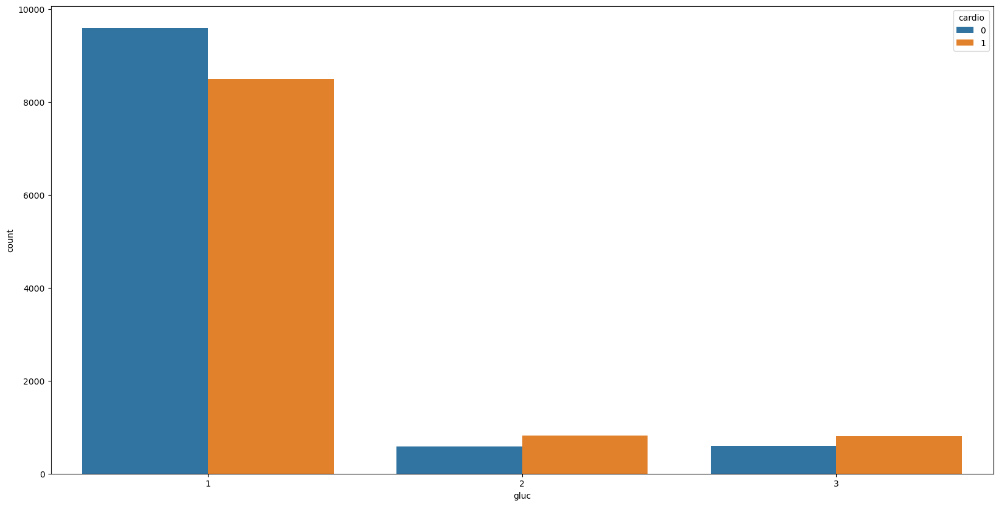

In [39]:
#1 is normal, 2 above normal, 3 is way above normal
sns.countplot(x='gluc', hue='cardio', data = male_df)

### Countplot for Female

<AxesSubplot:xlabel='gluc', ylabel='count'>

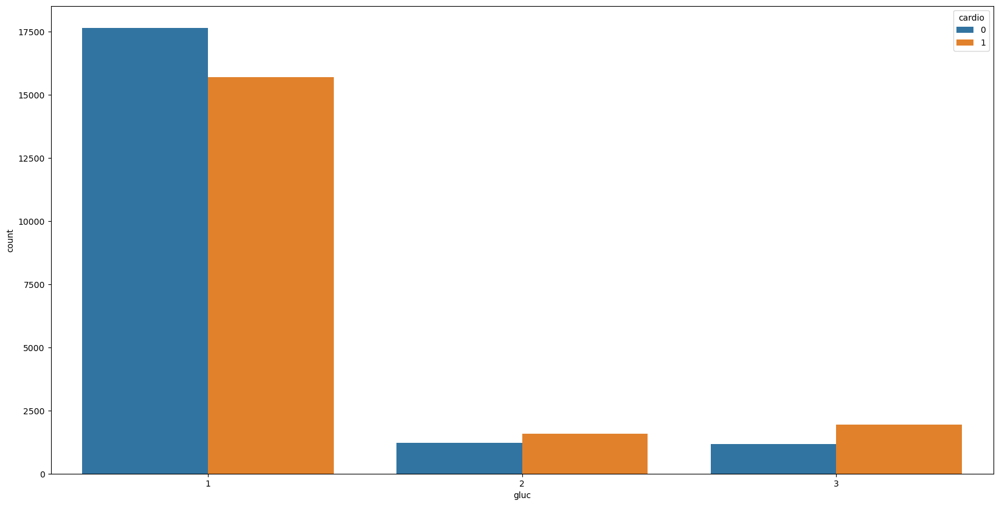

In [40]:
#1 is normal, 2 above normal, 3 is way above normal
sns.countplot(x='gluc', hue='cardio', data = female_df)

### High blood glucose from diabetes can damage your blood vessels and the nerves that control your heart and blood vessels. Over time, this damage can lead to heart disease. People with diabetes tend to develop heart disease at a younger age than people without diabetes

https://www.niddk.nih.gov/health-information/diabetes/overview/preventing-problems/heart-disease-stroke#:~:text=High%20blood%20glucose%20from%20diabetes,can%20lead%20to%20heart%20disease.&text=People%20with%20diabetes%20tend%20to,age%20than%20people%20without%20diabetes.

### Distribution plot for Male (ap_lo)

<AxesSubplot:xlabel='ap_lo', ylabel='Density'>

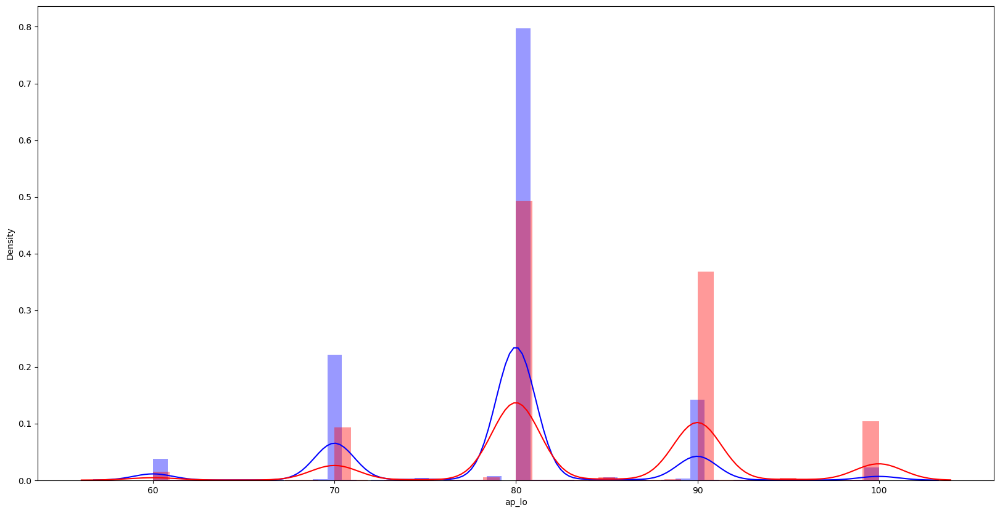

In [41]:
# create two overlapping distplots to compare the distribution of ap_lo for individuals with and without cardiovascular disease
sns.distplot(male_df['ap_lo'][male_df['cardio']==0], color='blue')
sns.distplot(male_df['ap_lo'][male_df['cardio']==1], color='red')

### Distribution plot for Female (ap_lo)

<AxesSubplot:xlabel='ap_lo', ylabel='Density'>

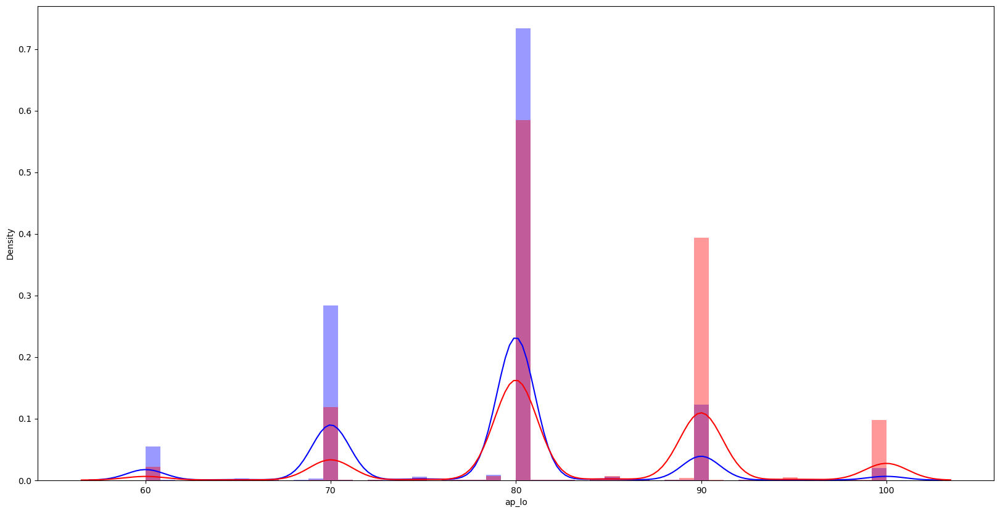

In [42]:
# create two overlapping distplots to compare the distribution of ap_lo for individuals with and without cardiovascular disease
sns.distplot(female_df['ap_lo'][female_df['cardio']==0], color='blue')
sns.distplot(female_df['ap_lo'][female_df['cardio']==1], color='red')

### Distribution plot for Female (ap_hi)

<AxesSubplot:xlabel='ap_hi', ylabel='Density'>

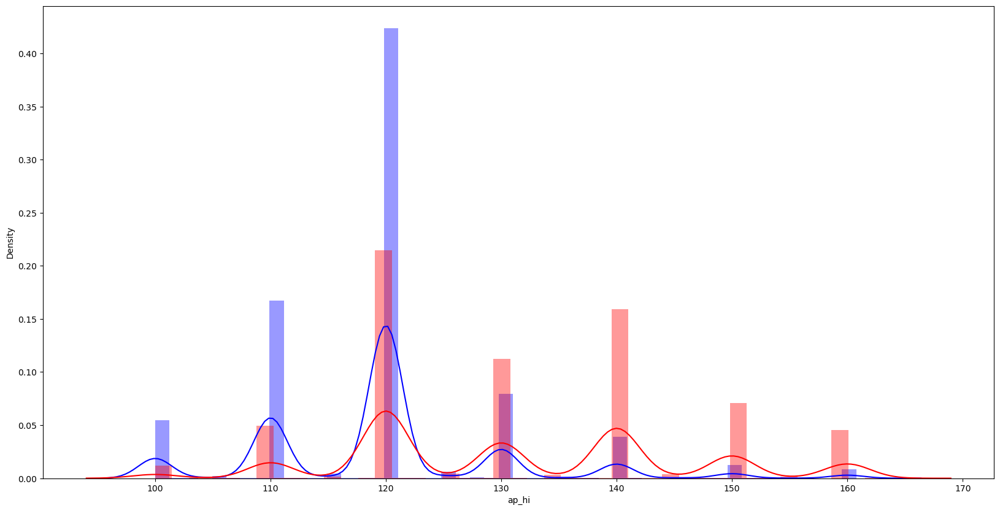

In [43]:
# create two overlapping distplots to compare the distribution of ap_lo for individuals with and without cardiovascular disease
sns.distplot(female_df['ap_hi'][female_df['cardio']==0], color='blue')
sns.distplot(female_df['ap_hi'][female_df['cardio']==1], color='red')

### Distribution plot for Male (ap_hi)

<AxesSubplot:xlabel='ap_hi', ylabel='Density'>

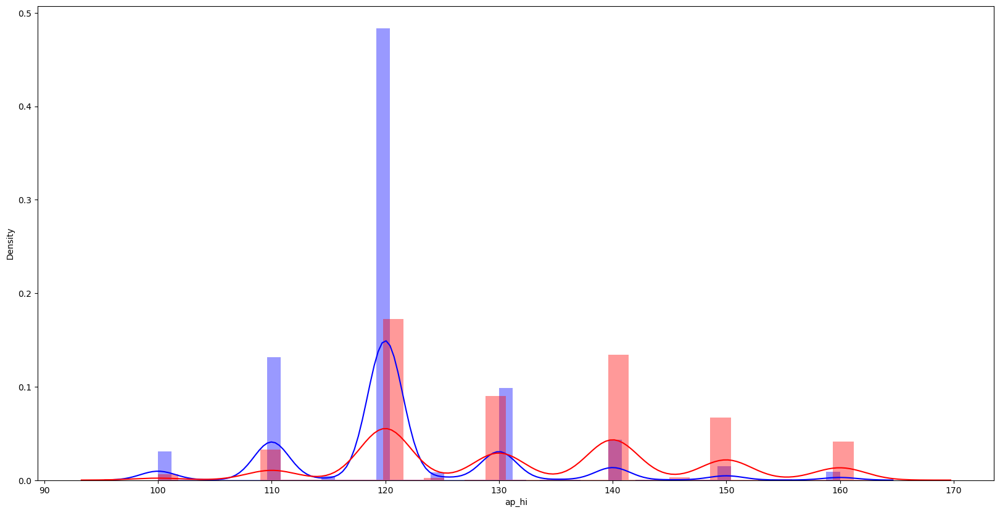

In [44]:
# create two overlapping distplots to compare the distribution of ap_lo for individuals with and without cardiovascular disease
sns.distplot(male_df['ap_hi'][male_df['cardio']==0], color='blue')
sns.distplot(male_df['ap_hi'][male_df['cardio']==1], color='red')

## Supervised Machine Learning (Predicting Outcome)

In [45]:
#Separate gender into 2 different dataframes
male_df = data[data['gender'] == 'Male']
female_df = data[data['gender'] == 'Female']

### Logistic Regression for Female

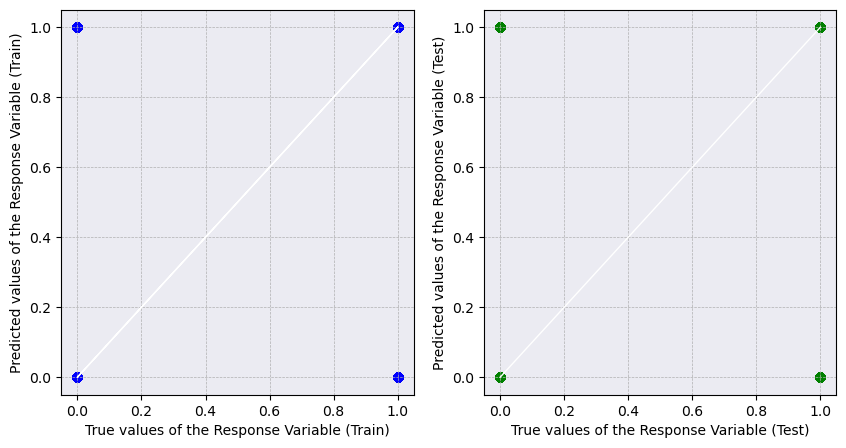

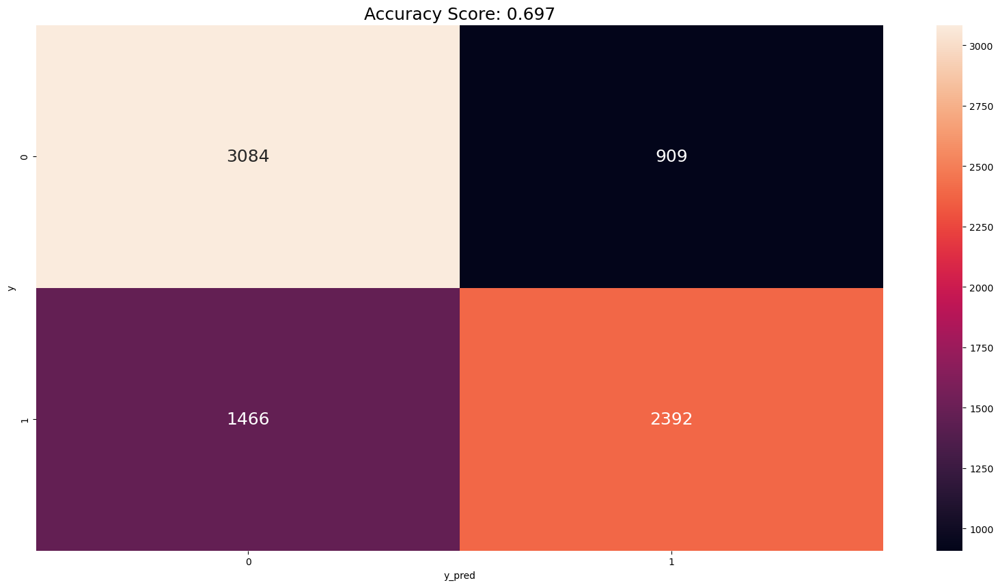

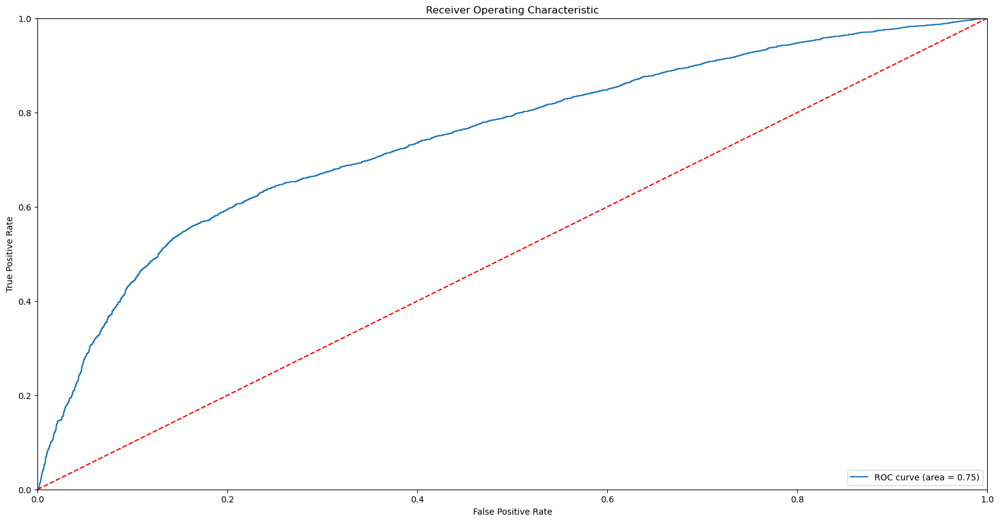

In [46]:
y = female_df["cardio"]
X = female_df.drop(["cardio", "gender_label", "gender"], axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=1)

#Train Data
log_model = LogisticRegression(solver = 'lbfgs', max_iter=1000).fit(X_train, y_train)

#Predict Response corresponding to Predictors
y_train_pred = log_model.predict(X_train)
y_test_pred = log_model.predict(X_test)

# Plot True vs Predicted Values
f, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].scatter(y_train, y_train_pred, color='blue')
axes[0].plot(y_train, y_train, 'w-', linewidth=1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[0].set_facecolor((0.92,0.92,0.95))
axes[0].grid(True, linestyle='--', linewidth=0.5)
axes[1].scatter(y_test, y_test_pred, color='green')
axes[1].plot(y_test, y_test, 'w-', linewidth=1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
axes[1].set_facecolor((0.92,0.92,0.95))
axes[1].grid(True, linestyle='--', linewidth=0.5)
plt.show()

def plot_confusion_matrix(y, y_pred):
    acc = round(accuracy_score(y, y_pred), 3)
    cm = confusion_matrix(y, y_pred)
    sns.heatmap(cm, annot=True, fmt = ".0f", annot_kws={"size": 18})
    plt.xlabel('y_pred')
    plt.ylabel('y')
    plt.title('Accuracy Score: {0}'.format(acc), size = 18)
    plt.show()
    
plot_confusion_matrix(y_test, y_test_pred)

from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

y_pred_prob = log_model.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = roc_auc_score(y_test, y_pred_prob)

plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()


### Logistic Regression for Male

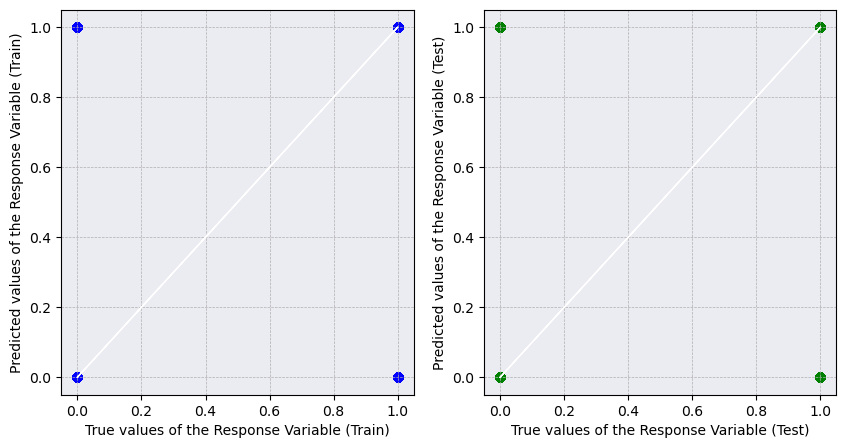

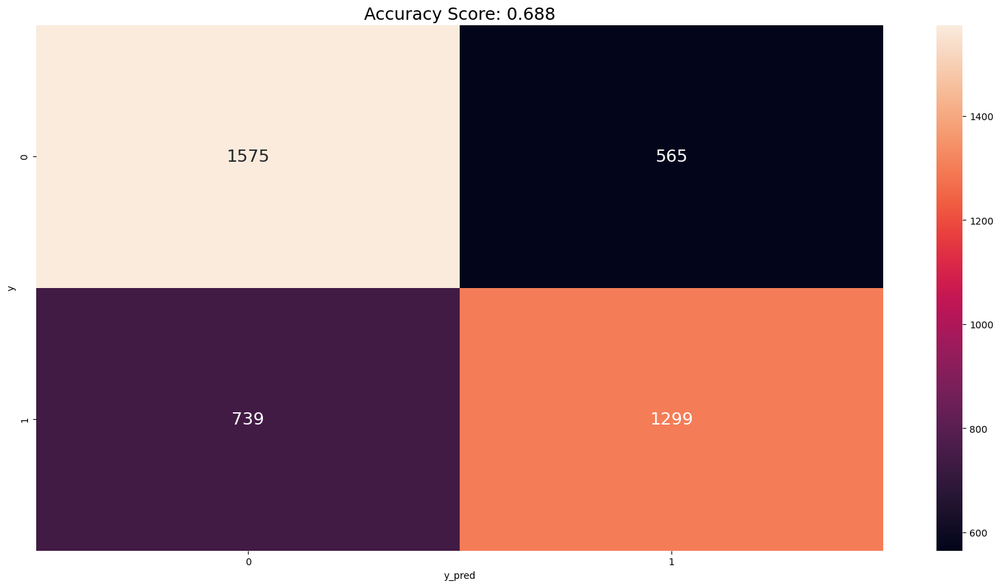

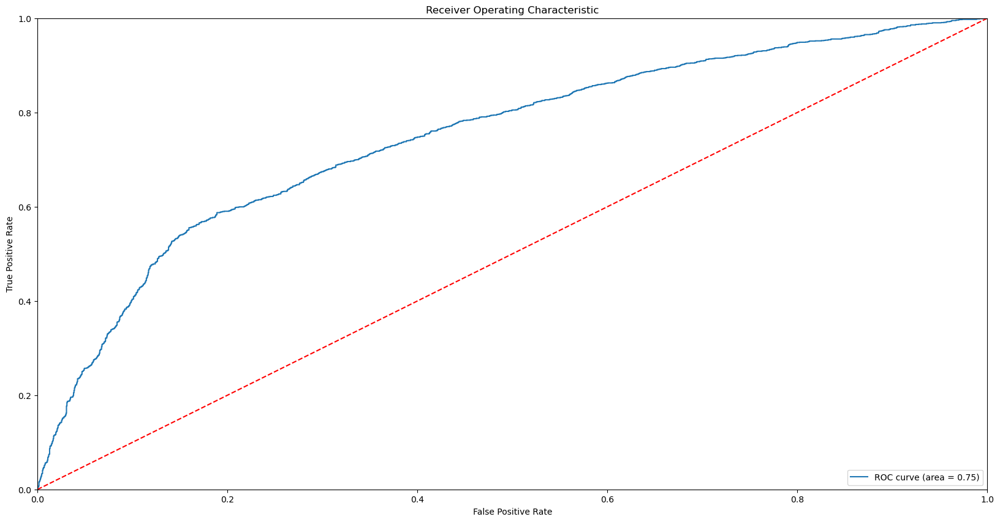

In [47]:
y = male_df["cardio"]
X = male_df.drop(["cardio", "gender_label", "gender"], axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=1)

#Train Data
log_model = LogisticRegression(solver = 'lbfgs', max_iter=1000).fit(X_train, y_train)

#Predict Response corresponding to Predictors
y_train_pred = log_model.predict(X_train)
y_test_pred = log_model.predict(X_test)

# Plot True vs Predicted Values
f, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].scatter(y_train, y_train_pred, color='blue')
axes[0].plot(y_train, y_train, 'w-', linewidth=1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[0].set_facecolor((0.92,0.92,0.95))
axes[0].grid(True, linestyle='--', linewidth=0.5)
axes[1].scatter(y_test, y_test_pred, color='green')
axes[1].plot(y_test, y_test, 'w-', linewidth=1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
axes[1].set_facecolor((0.92,0.92,0.95))
axes[1].grid(True, linestyle='--', linewidth=0.5)
plt.show()

def plot_confusion_matrix(y, y_pred):
    acc = round(accuracy_score(y, y_pred), 3)
    cm = confusion_matrix(y, y_pred)
    sns.heatmap(cm, annot=True, fmt = ".0f", annot_kws={"size": 18})
    plt.xlabel('y_pred')
    plt.ylabel('y')
    plt.title('Accuracy Score: {0}'.format(acc), size = 18)
    plt.show()
    
plot_confusion_matrix(y_test, y_test_pred)

from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

y_pred_prob = log_model.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = roc_auc_score(y_test, y_pred_prob)

plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()


### Linear Regression for Female

Intercept of Regression 	: b =  -1.9122341433233168
Coefficients of Regression 	: a =  [-2.82519627e-08  1.07614544e-02 -6.16552502e-04  1.98452869e-03
  1.21065053e-02  2.39489793e-03  9.69133423e-02 -1.86429125e-02
 -7.30843709e-03 -3.43147733e-02 -4.39793591e-02]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.22833876494938932
Mean Squared Error (MSE) 	: 0.19283240268074578

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.2328082021029092
Mean Squared Error (MSE) 	: 0.1917412392268538



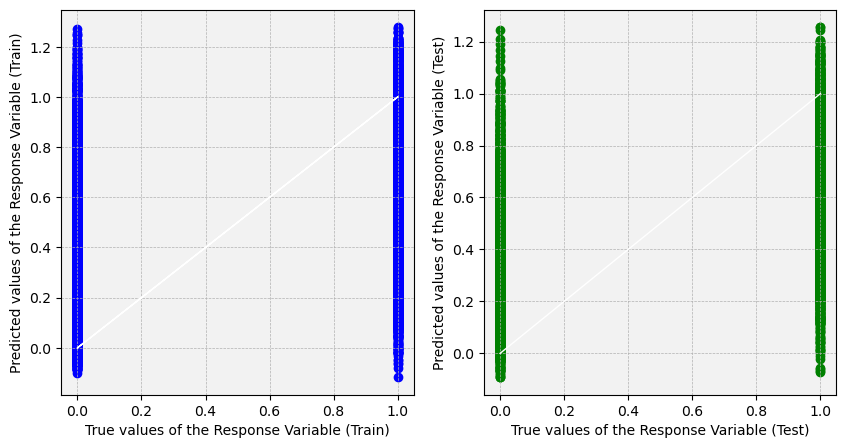

In [48]:
y = female_df["cardio"]
X = female_df.drop(["cardio", "gender_label", "gender"], axis = 1)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.20, random_state=1)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot True vs Predicted Values
f, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].scatter(y_train, y_train_pred, color='blue')
axes[0].plot(y_train, y_train, 'w-', linewidth=1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[0].set_facecolor((0.95, 0.95, 0.95))
axes[0].grid(True, linestyle='--', linewidth=0.5)
axes[1].scatter(y_test, y_test_pred, color='green')
axes[1].plot(y_test, y_test, 'w-', linewidth=1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
axes[1].set_facecolor((0.95, 0.95, 0.95))
axes[1].grid(True, linestyle='--', linewidth=0.5)
plt.show()

### Linear Regression for Male

Intercept of Regression 	: b =  -1.6200382253597305
Coefficients of Regression 	: a =  [-4.84339743e-08  9.26541464e-03 -2.68008798e-03  3.10941134e-03
  1.32925947e-02  1.33339004e-03  9.61025815e-02 -1.71899638e-02
 -4.44397167e-02 -3.22724956e-02 -5.99165059e-02]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.22937199682570042
Mean Squared Error (MSE) 	: 0.19246464744975808

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.21216585611699823
Mean Squared Error (MSE) 	: 0.1968411440307818



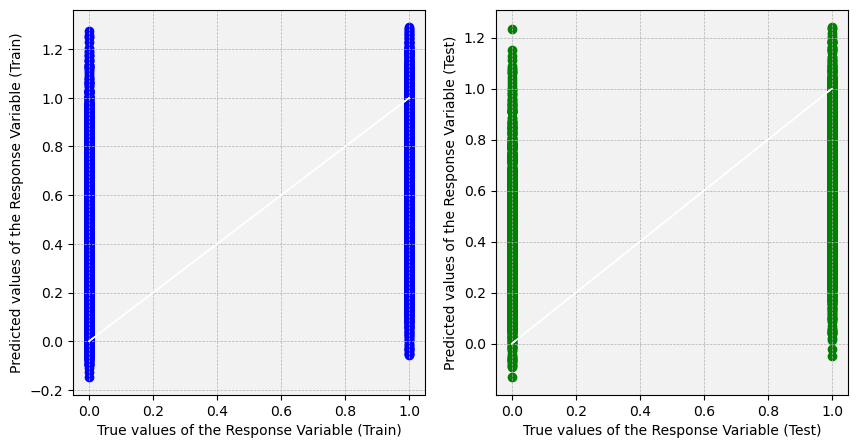

In [49]:
y = male_df["cardio"]
X = male_df.drop(["cardio", "gender_label", "gender"], axis = 1)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.20, random_state=1)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot True vs Predicted Values
f, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].scatter(y_train, y_train_pred, color='blue')
axes[0].plot(y_train, y_train, 'w-', linewidth=1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[0].set_facecolor((0.95, 0.95, 0.95))
axes[0].grid(True, linestyle='--', linewidth=0.5)
axes[1].scatter(y_test, y_test_pred, color='green')
axes[1].plot(y_test, y_test, 'w-', linewidth=1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
axes[1].set_facecolor((0.95, 0.95, 0.95))
axes[1].grid(True, linestyle='--', linewidth=0.5)
plt.show()

### Decision Tree for Female

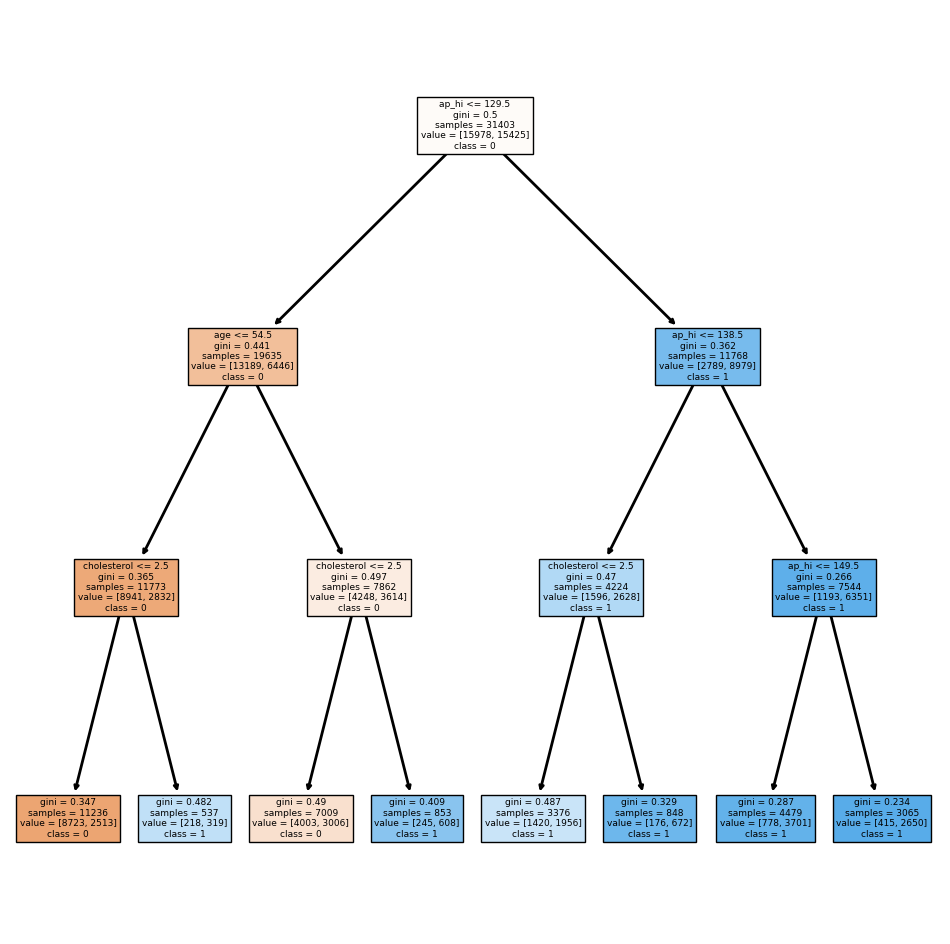

Classification Accuracy 	: 0.7206954749546222


In [50]:
# Import Decision Tree Classifier model from Scikit-Learn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

# Create a Decision Tree Classifier object
dectree = DecisionTreeClassifier(max_depth=3)

#First uni-variate: cardiovascular disease vs all data except cardiovascular disease
y = female_df["cardio"]
X = female_df.drop(["cardio", "gender_label", "gender"], axis=1)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

# Train the Decision Tree Classifier model
dectree.fit(X_train, y_train)

from sklearn.tree import plot_tree
fig, ax = plt.subplots(figsize=(12, 12))
out = plot_tree(dectree, 
          feature_names=X_train.columns,
          class_names=[str(x) for x in dectree.classes_],  # use classes_ instead of classes
          filled=True)

for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor('black')
        arrow.set_linewidth(2)

plt.show()

# Predict the Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)

# Print the Classification Accuracy
print("Classification Accuracy \t:", dectree.score(X_train, y_train))


### Decision Tree for Male

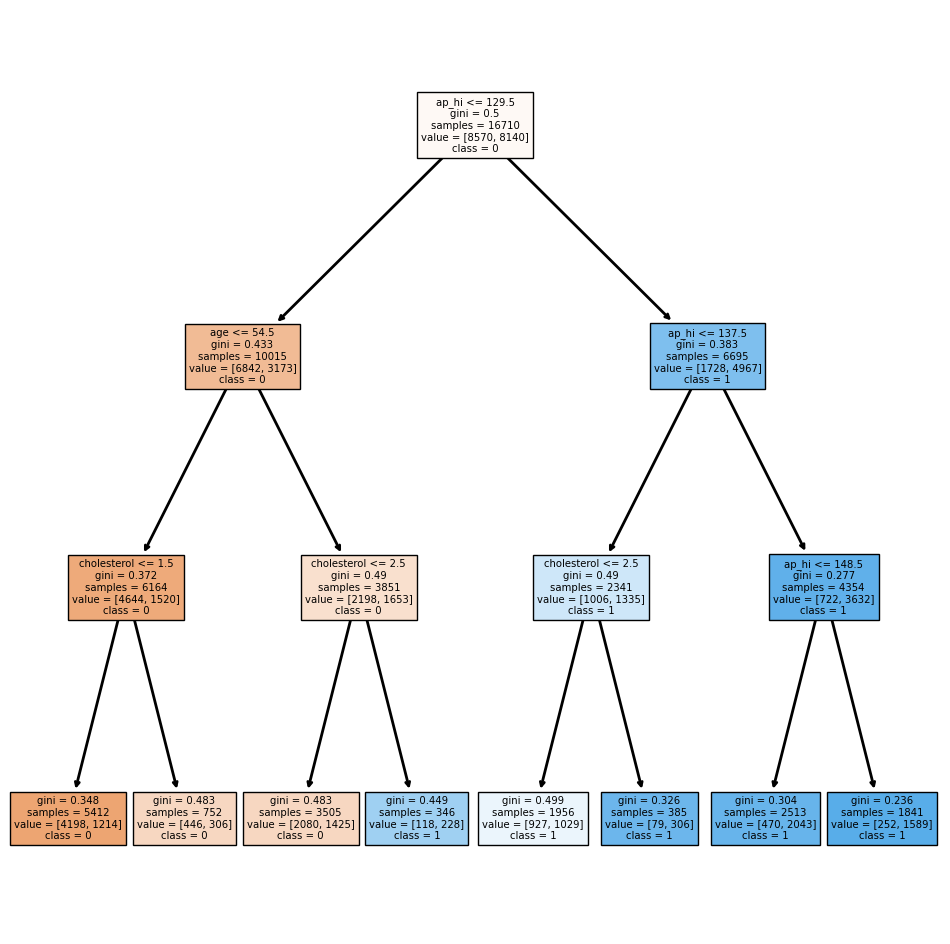

Classification Accuracy 	: 0.7132854578096948


In [51]:
# Import Decision Tree Classifier model from Scikit-Learn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

# Create a Decision Tree Classifier object
dectree = DecisionTreeClassifier(max_depth=3)

#First uni-variate: cardiovascular disease vs all data except cardiovascular disease
y = male_df["cardio"]
X = male_df.drop(["cardio", "gender_label", "gender"], axis=1)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

# Train the Decision Tree Classifier model
dectree.fit(X_train, y_train)

from sklearn.tree import plot_tree
fig, ax = plt.subplots(figsize=(12, 12))
out = plot_tree(dectree, 
          feature_names=X_train.columns,
          class_names=[str(x) for x in dectree.classes_],  # use classes_ instead of classes
          filled=True)

for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor('black')
        arrow.set_linewidth(2)

plt.show()

# Predict the Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)

# Print the Classification Accuracy
print("Classification Accuracy \t:", dectree.score(X_train, y_train))


### Gaussian Naive Bayes for Female

In [52]:
from sklearn.naive_bayes import GaussianNB
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load iris dataset
y = female_df["cardio"]
X = female_df.drop(["cardio", "gender_label", "gender"], axis=1)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create Gaussian Naive Bayes object and fit the data
gnb = GaussianNB()
gnb.fit(X_train, y_train)

# Predict the classes on test set
y_pred = gnb.predict(X_test)

# Calculate the accuracy score
accuracy = accuracy_score(y_test, y_pred)
print('Test Accuracy:', accuracy)

Test Accuracy: 0.711629091835435


### Gaussian Naive Bayes for Male

In [53]:
from sklearn.naive_bayes import GaussianNB
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load iris dataset
y = male_df["cardio"]
X = male_df.drop(["cardio", "gender_label", "gender"], axis=1)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create Gaussian Naive Bayes object and fit the data
gnb = GaussianNB()
gnb.fit(X_train, y_train)

# Predict the classes on test set
y_pred = gnb.predict(X_test)

# Calculate the accuracy score
accuracy = accuracy_score(y_test, y_pred)
print('Test Accuracy:', accuracy)

Test Accuracy: 0.6996170416467209
